In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [4]:
%tensorflow_version 2.x

TensorFlow 2.x selected.


In [5]:
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import re 

#Ruta raiz
PATH = "/content/drive/My Drive/ConcursoDotCsv/Dataset/example_BtoA/"

INPATH = PATH + "trazos_B"


imgurls = !ls -1 "{INPATH}"



def sorted_nicely( l ): 
    """ Sort the given iterable in the way that humans expect.""" 
    convert = lambda text: int(text) if text.isdigit() else text 
    alphanum_key = lambda key: [ convert(c) for c in re.split('([0-9]+)', key) ] 
    return sorted(l, key = alphanum_key)

imgurls = sorted_nicely(imgurls)

print(len(imgurls))

161


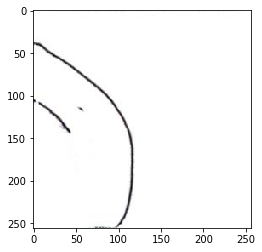

In [6]:
# Fcuniones para para cargar las imagenes a la red

def normalize(inimg):
  inimg = (inimg/127.5) - 1 

  return inimg

def load_image(filename):

  inimg = tf.cast(tf.image.decode_jpeg(tf.io.read_file(INPATH + '/' + filename)),tf.float32)[...,:3]

  inimg= normalize(inimg)

  return inimg

plt.imshow((load_image(imgurls[0]) + 1)/2)

In [7]:
evaluate_dataset = tf.data.Dataset.from_tensor_slices(imgurls)
evaluate_dataset = evaluate_dataset.map(load_image,num_parallel_calls=tf.data.experimental.AUTOTUNE)
evaluate_dataset = evaluate_dataset.batch(1)

In [0]:
# En este caso como no vamos a entrenar el modelo solo nos interesa la red generadora

from tensorflow.keras import *
from tensorflow.keras.layers import *

def downsample(filters, apply_batchnorm=True):

  result = Sequential() 

  initializer = tf.random_normal_initializer(0,0.02)

  #capa convolucional 

  result.add(Conv2D(filters,
                    kernel_size = 4,
                    strides = 2,
                    padding = "same",
                    kernel_initializer = initializer,
                    use_bias = not apply_batchnorm))

  # Capa de batch normalization 

  if apply_batchnorm:
    result.add(BatchNormalization())

  #Capa de activacion (leak relu)

  result.add(ReLU()) 

  return result 

downsample(64)

def upsample(filters, apply_dropout=False):

  result = Sequential() 

  initializer = tf.random_normal_initializer(0,0.02)

  #capa convolucional 

  result.add(Conv2DTranspose(filters,
                             kernel_size = 4,
                             strides = 2,
                             padding = "same",
                             kernel_initializer = initializer,
                             use_bias = False))

  # Capa de batch normalization 
  result.add(BatchNormalization())

  if apply_dropout:
    result.add(Dropout(0.5))
    

  #Capa de activacion (leak relu)
  result.add(ReLU()) 

  return result

upsample(64)


def Generator():
  inputs = tf.keras.layers.Input(shape=[None,None,3])

  down_stack = [
    downsample(64, apply_batchnorm=False),
    downsample(128),
    downsample(256),
    downsample(512),
    downsample(512),
    downsample(512),
    downsample(512),
    downsample(512),
  ]

  up_stack = [ 
    upsample(512,apply_dropout=True),
    upsample(512,apply_dropout=True),
    upsample(512,apply_dropout=True),
    upsample(512),
    upsample(256),
    upsample(128),
    upsample(64),
  ]

  initializer = tf.random_normal_initializer(0,0.02)

  last = Conv2DTranspose(filters=3,
                         kernel_size = 4,
                         strides = 2,
                         padding = "same",
                         kernel_initializer = initializer,
                         activation = "tanh")
  

  x = inputs

  s = []

  concat = Concatenate()

  for down in down_stack:
    x = down(x)
    s.append(x)

  s = reversed(s[:-1])

  for up,sk in zip(up_stack,s):
    x = up(x)
    x = concat([x,sk])

  last = last(x)

  return Model(inputs = inputs, outputs = last)

generator = Generator()



In [9]:
#Cargando modelo entrenado, en este caso model_trained_AtoB

checkpoint = tf.train.Checkpoint(generator = generator)

checkpoint.restore(tf.train.latest_checkpoint("/content/drive/My Drive/ConcursoDotCsv/Dataset/model_trained_BtoA/checkpoints"))

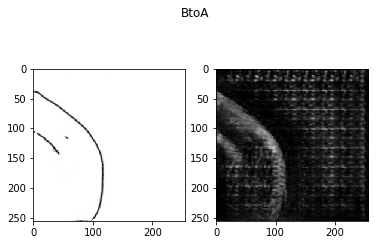

In [10]:
# prueba de que el modelo entrenado fue cargado correctamente 

for inimg in evaluate_dataset.take(1):
  w1 = inimg

gen_output = generator(w1,training=False)


fig, axs = plt.subplots(1,2)
fig.suptitle('BtoA')
axs[0].imshow((inimg[0,...]+1)/2)
axs[1].imshow((gen_output[0,...]+1)/2)

In [0]:
# Funcion que evalua cada imagen en el modelo 
#Como queremos crear un modelo 3D a partir de las salidas en ImageJ entonces al guardar colocamos 1-prediction[0,...] 
#para obtener el negativo de la imagen 

def generate_images(model,evaluate_input,num_img=False,display_imgs=True):

  prediction = model(evaluate_input)
  
  if num_img:
    save_filename = str(num_img)
    tf.keras.preprocessing.image.save_img(PATH + "results/" + save_filename + ".jpg",prediction[0,...])

  plt.figure(figsize=(10,10))

  display_list = [evaluate_input[0],prediction[0]]

  title = ["Input Image" , "Predicted Image"]

  if display_imgs: 
    for i in range(2):
      plt.subplot(1,2,i+1)
      plt.title(title[i])
      # getting the pixel value between [0,1] to plot it.
      plt.imshow(display_list[i]*0.5 + 0.5)
      plt.axis("off")

  plt.show()
  return (1-prediction[0,...])

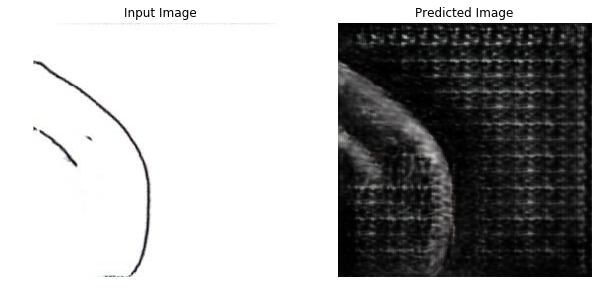

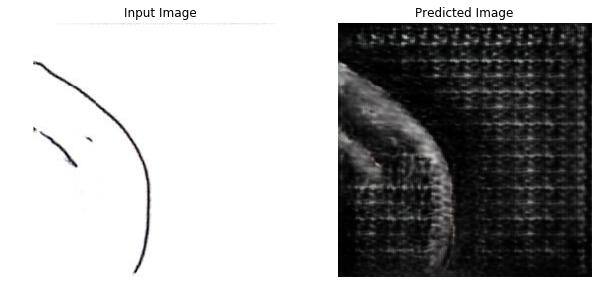

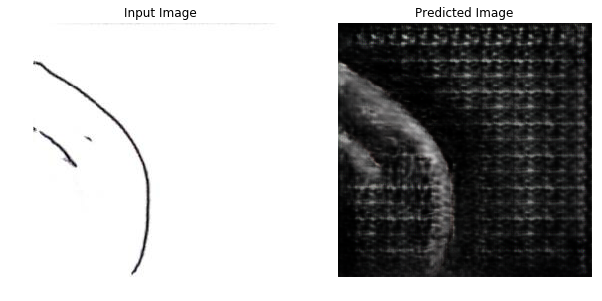

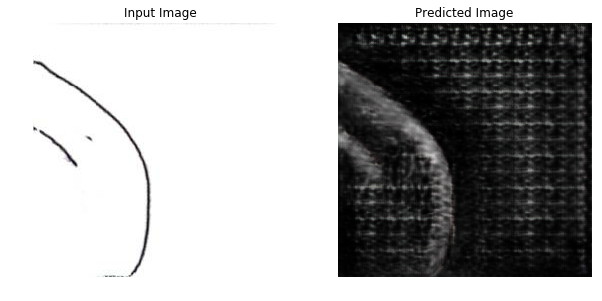

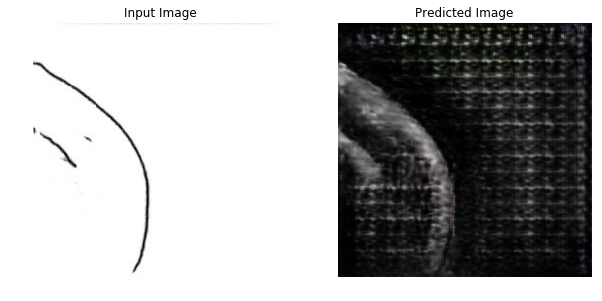

...

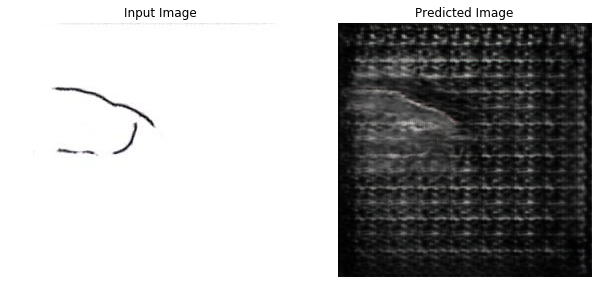

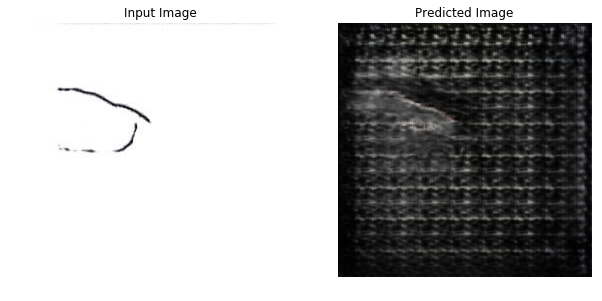

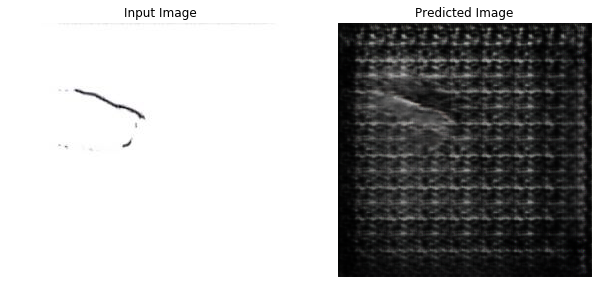

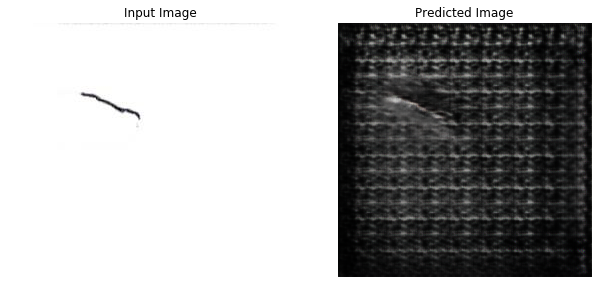

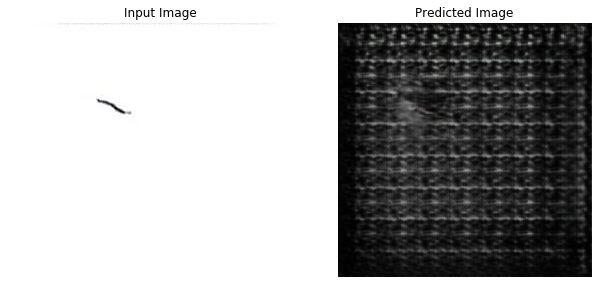

In [12]:
for i,inp in enumerate(evaluate_dataset.take(161)):
  generate_images(generator,inp,i)

In [0]:
import os,sys,cv2
path = '/content/drive/My Drive/ConcursoDotCsv/Dataset/example_BtoA/results'#"/content/drive/My Drive/Modelo/DSSE-200-release/Annotations"
dirs = os.listdir( path)
c = 0
for file in dirs:
  if file != 'masks':
    zona = os.path.join(path,file)
    image = cv2.imread(zona,0)
    
    zona2 = os.path.join('/content/romo',file[:-4]+".png")
    cv2.imwrite(zona2,image)
    c = c + 1
    print(c)

In [0]:
im = cv2.imread("/content/romo/1.png")

In [0]:
from skimage import io
import numpy as np
import os


import os,sys,cv2

stack = np.zeros((168,256,256))
path = '/content/drive/My Drive/ConcursoDotCsv/Dataset/example_BtoA/results'#"/content/drive/My Drive/Modelo/DSSE-200-release/Annotations"
dirs = os.listdir( path)
c = 0
for i,file in enumerate(dirs):
  zona = os.path.join(path,file)
  image = cv2.imread(zona,0)
  stack[i,:,:]= image

path_results = '/content/drive/My Drive/ConcursoDotCsv/Dataset/example_BtoA/'
io.imsave(path_results+'Stack.tif' ,stack)



In [0]:
stack = np.zeros((1,256,256))

In [36]:
np.shape(stack)

(5, 256, 256)

array([[[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

    